# Image Filtering

In [3]:
# !pip install opencv-python

In [4]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
from PIL import Image, ImageFilter
from skimage.filters import threshold_local
from matplotlib.gridspec import GridSpec
import matplotlib.image as mpimg

In [5]:
image_path = "I:/My Drive/Image_filtering/images/images/animated1.jpg"
# image_path = "/Users/user/Downloads/images/animated1.jpg"
bgr_image = cv2.imread(image_path)
original_image = cv2.cvtColor(bgr_image, cv2.COLOR_BGR2RGB)

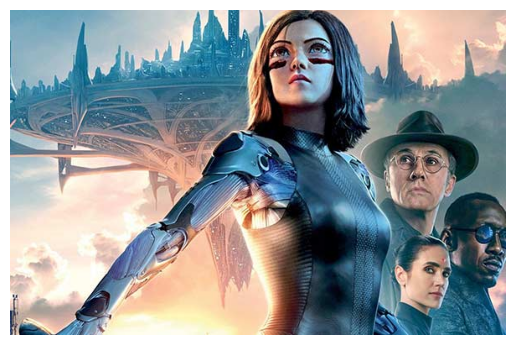

In [6]:
plt.imshow(original_image)
plt.axis('off')
plt.show()

In [7]:
if original_image is None:
    print("Error: Unable to load the image.")
else:
    def generate_film_grain(image):
        film_grain_noise = np.random.normal(loc=1, scale=1, size=image.shape).astype(np.uint8)
        return cv2.add(image, film_grain_noise)

    def generate_periodic(image):
        periodic_noise = np.zeros(image.shape, dtype=np.uint8)
        periodic_noise[::5, ::5, :] = 255
        return cv2.add(image, periodic_noise)

    def generate_speckle(image):
        speckle_noise = np.random.normal(loc=1, scale=0.5, size=image.shape) * 255
        return cv2.add(image, speckle_noise.astype(np.uint8))

    def generate_salt_and_pepper(image):
        salt_pepper_noise = np.random.choice([0, 255], size=image.shape[:2] + (image.shape[2],), p=[0.89, 0.11]).astype(np.uint8)
        return cv2.add(image, salt_pepper_noise)

    def generate_gaussian(image):
        gaussian_noise = np.random.normal(loc=1, scale=2, size=image.shape).astype(np.uint8)
        return cv2.add(image, gaussian_noise)

    noise_generators = {
        'Film Grain': generate_film_grain,
        'Periodic': generate_periodic,
        'Speckle': generate_speckle,
        'Salt-and-Pepper': generate_salt_and_pepper,
        'Gaussian': generate_gaussian
    }

    noisy_images = {noise_type: noise_generator(original_image) for noise_type, noise_generator in noise_generators.items()}

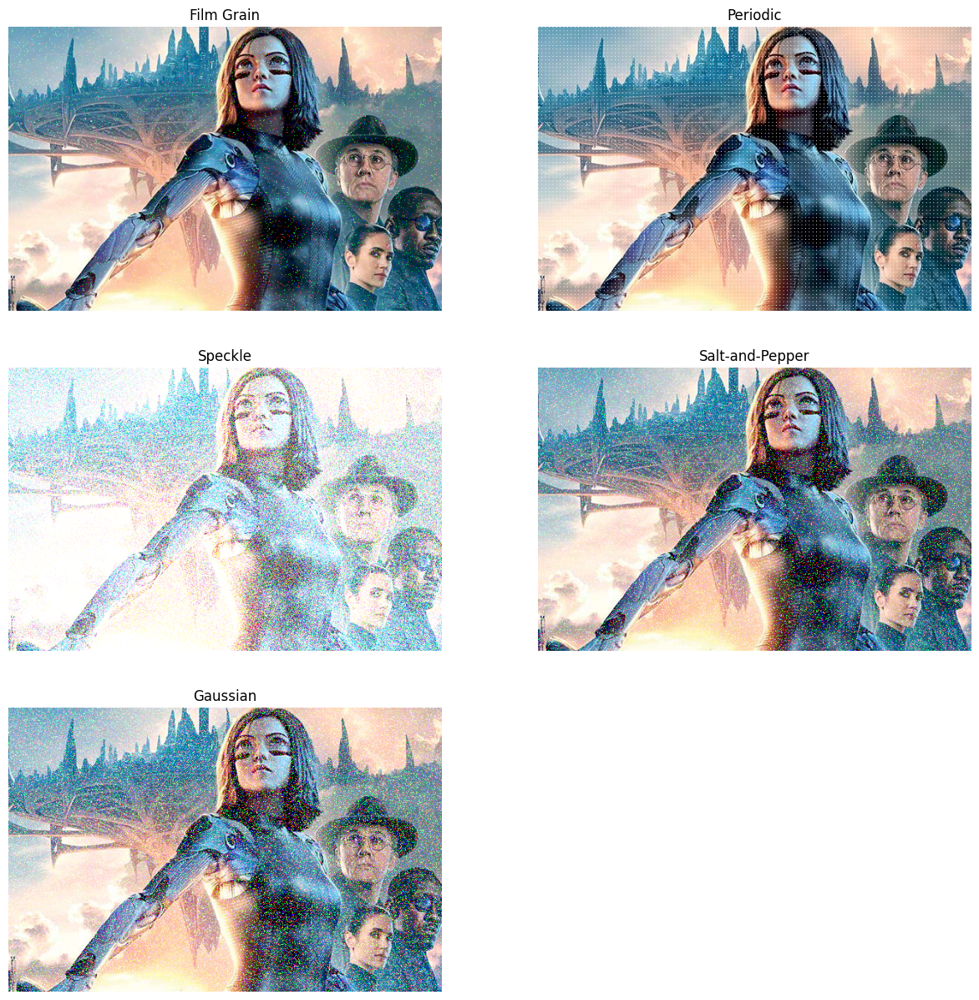

In [8]:
plt.figure(figsize=(15, 15))
for i, (noise_type, noisy_image) in enumerate(noisy_images.items(), start=1):
        plt.subplot(3, 2, i)
        plt.imshow(noisy_image)
        plt.title(noise_type)
        plt.axis('off')
plt.show()

# Linear Filtering

## BOX Filter

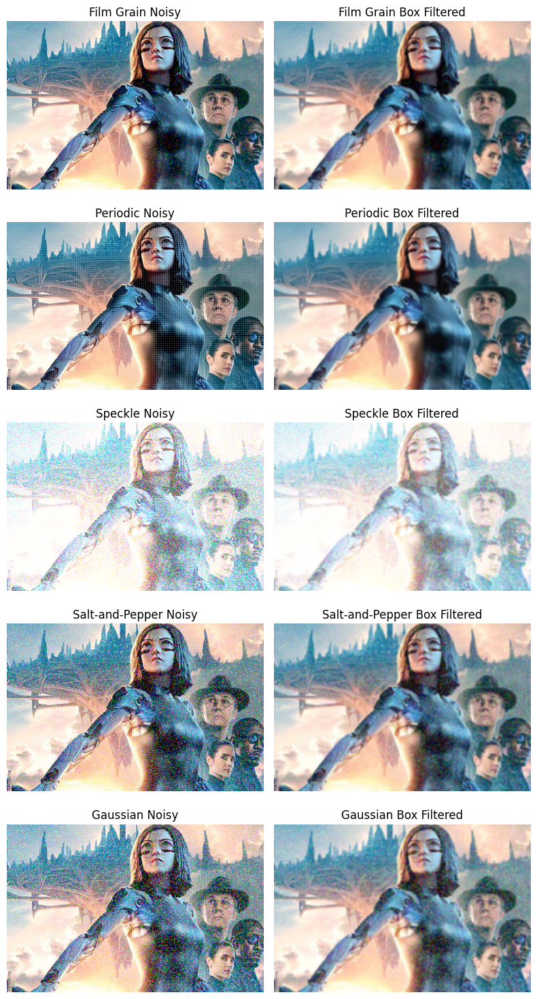

In [9]:
def apply_box_filter(image):
    return cv2.boxFilter(image, -1, (5, 5))

plt.figure(figsize=(8, 15))

for noise_type, noisy_image in noisy_images.items():
    plt.subplot(len(noisy_images), 2, 2*(list(noisy_images.keys()).index(noise_type)) + 1)
    plt.imshow(noisy_image)
    plt.title(noise_type + ' Noisy', fontsize=12)
    plt.axis('off')

    box_filtered = apply_box_filter(noisy_image)

    plt.subplot(len(noisy_images), 2, 2*(list(noisy_images.keys()).index(noise_type)) + 2)
    plt.imshow(box_filtered)
    plt.title(noise_type + ' Box Filtered', fontsize=12)
    plt.axis('off')

plt.tight_layout()
plt.savefig('box_filter_output.png', bbox_inches='tight')
plt.show()

## Gaussian Filter

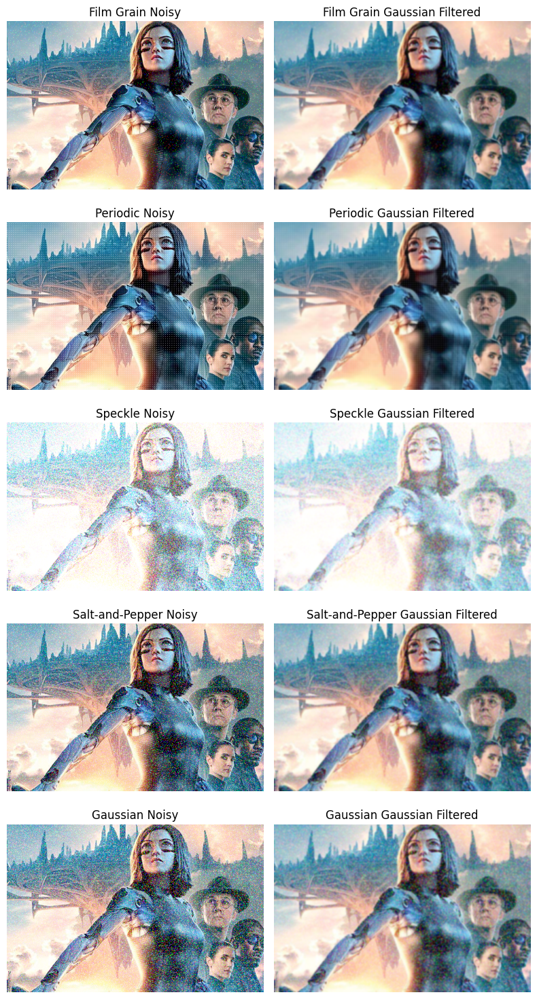

In [10]:
def apply_gaussian_filter(image):
    return cv2.GaussianBlur(image, (11, 11), sigmaX=1.5)

plt.figure(figsize=(8, 15))

for i, (noise_type, noisy_image) in enumerate(noisy_images.items()):
    plt.subplot(len(noisy_images), 2, 2*i + 1)
    plt.imshow(noisy_image)
    plt.title(noise_type + ' Noisy', fontsize=12)
    plt.axis('off')

    gaussian_filtered = apply_gaussian_filter(noisy_image)

    plt.subplot(len(noisy_images), 2, 2*i + 2)
    plt.imshow(gaussian_filtered)
    plt.title(noise_type + ' Gaussian Filtered', fontsize=12)
    plt.axis('off')

plt.tight_layout()
plt.savefig('gaussian_filter_output.png', bbox_inches='tight')
plt.show()

## Sobel

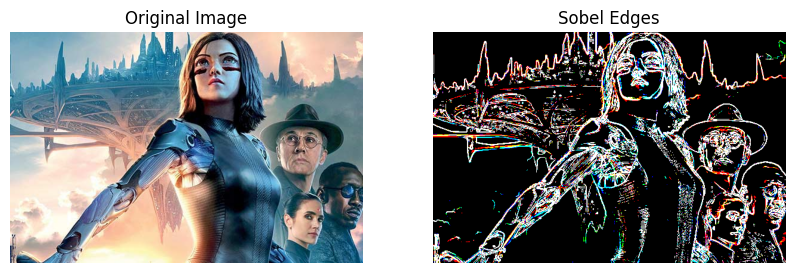

In [11]:
if original_image is None:
    print("Error: Unable to load the image.")
else:
    sobel_x = cv2.Sobel(original_image, cv2.CV_64F, 1, 0, ksize=3)
    sobel_y = cv2.Sobel(original_image, cv2.CV_64F, 0, 1, ksize=3)

    sobel_mag = np.sqrt(sobel_x**2 + sobel_y**2)

    threshold = 130
    sobel_edges = np.where(sobel_mag > threshold, 255, 0).astype(np.uint8)

    plt.figure(figsize=(10, 5))
    plt.subplot(1, 2, 1)
    plt.imshow(original_image, cmap='gray')
    plt.title('Original Image')
    plt.axis('off')

    plt.subplot(1, 2, 2)
    plt.imshow(sobel_edges, cmap='gray')
    plt.title('Sobel Edges')
    plt.axis('off')
    plt.savefig('sobel_filter_output.png', bbox_inches='tight')
    plt.show()

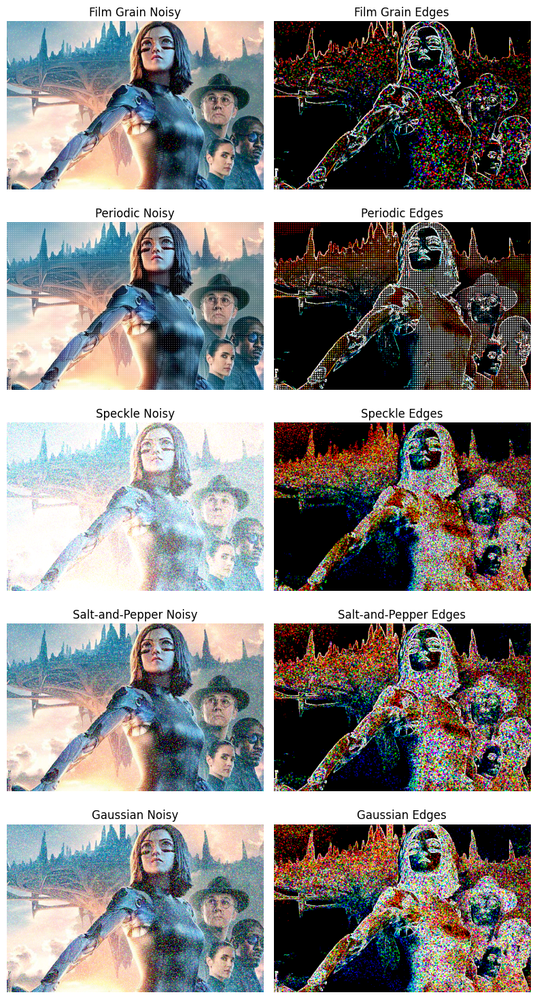

In [12]:
def detect_edges(image):
    sobel_x = cv2.Sobel(image, cv2.CV_64F, 1, 0, ksize=3)
    sobel_y = cv2.Sobel(image, cv2.CV_64F, 0, 1, ksize=3)
    sobel_mag = np.sqrt(sobel_x**2 + sobel_y**2)
    threshold = 255
    sobel_edges = np.where(sobel_mag > threshold, 255, 0).astype(np.uint8)
    return sobel_edges

plt.figure(figsize=(8, 15))

for i, (noise_type, noisy_image) in enumerate(noisy_images.items()):
    plt.subplot(len(noisy_images), 2, 2*i + 1)
    plt.imshow(noisy_image)
    plt.title(noise_type + ' Noisy', fontsize=12)
    plt.axis('off')

    plt.subplot(len(noisy_images), 2, 2*i + 2)
    edges = detect_edges(noisy_image)
    plt.imshow(edges, cmap='gray')
    plt.title(noise_type + ' Edges', fontsize=12)
    plt.axis('off')

plt.tight_layout()
plt.savefig('sobel_filter2_output.png', bbox_inches='tight')
plt.show()

# Non-linear Filtering

##  Median Filter

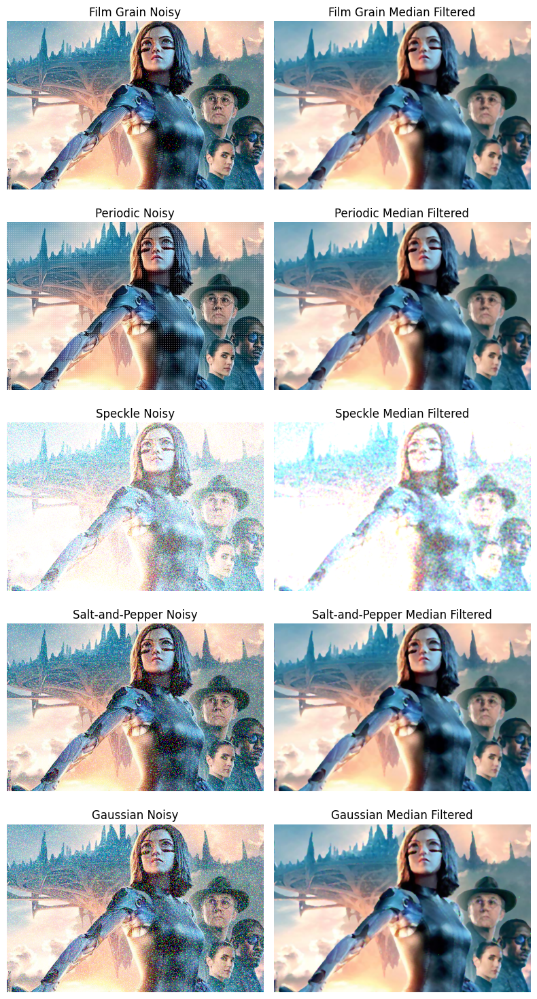

In [13]:
def apply_median_filter(image):
    return cv2.medianBlur(image, 5)

plt.figure(figsize=(8, 15))

for i, (noise_type, noisy_image) in enumerate(noisy_images.items()):
    plt.subplot(len(noisy_images), 2, 2*i + 1)
    plt.imshow(noisy_image)
    plt.title(noise_type + ' Noisy', fontsize=12)
    plt.axis('off')

    # noisy_image_gray = cv2.cvtColor(noisy_image, cv2.COLOR_BGR2GRAY)
    median_filtered = apply_median_filter(noisy_image)

    plt.subplot(len(noisy_images), 2, 2*i + 2)
    plt.imshow(median_filtered, cmap='gray')
    plt.title(noise_type + ' Median Filtered', fontsize=12)
    plt.axis('off')

plt.tight_layout()
plt.savefig('median_filter_output.png', bbox_inches='tight')
plt.show()

## Rank Filter

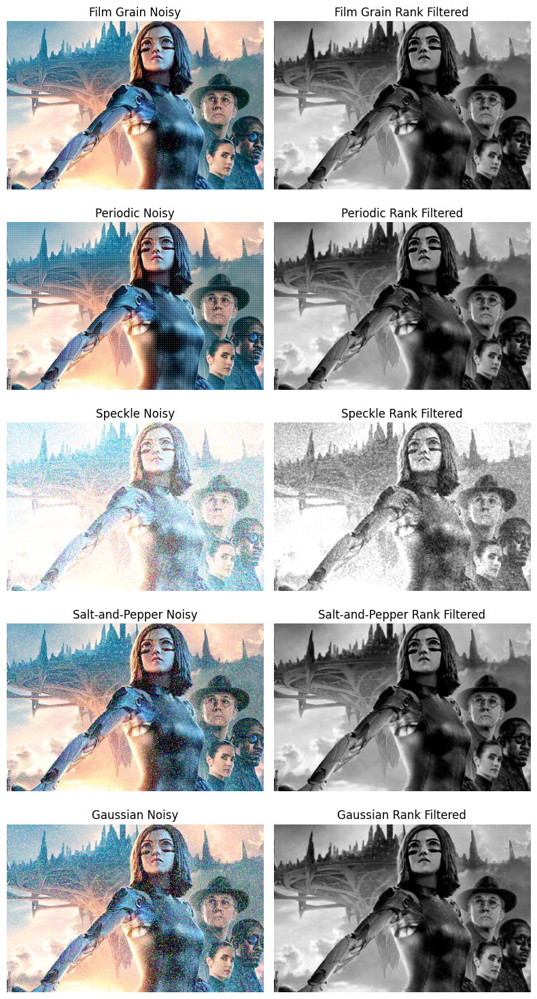

In [14]:
def apply_rank_filter(image):
    kernel_size = 3
    rank = 4

    padded_image = cv2.copyMakeBorder(image, 1, 1, 1, 1, cv2.BORDER_REPLICATE)
    filtered_image = np.zeros_like(image)

    for y in range(image.shape[0]):
        for x in range(image.shape[1]):
            neighborhood = padded_image[y:y+kernel_size, x:x+kernel_size]
            sorted_neighborhood = np.sort(neighborhood.flatten())
            filtered_image[y, x] = sorted_neighborhood[rank]

    return filtered_image

num_noises = len(noisy_images)
num_images = num_noises

plt.figure(figsize=(8, 15))

for i, (noise_type, noisy_image) in enumerate(noisy_images.items()):
    plt.subplot(len(noisy_images), 2, 2*i + 1)
    plt.imshow(noisy_image)
    plt.title(noise_type + ' Noisy', fontsize=12)
    plt.axis('off')

    # noisy_image_gray = cv2.cvtColor(noisy_image, cv2.COLOR_BGR2GRAY)
    rank_filtered = apply_rank_filter(noisy_image)

    plt.subplot(len(noisy_images), 2, 2*i + 2)
    plt.imshow(rank_filtered)
    plt.title(noise_type + ' Rank Filtered', fontsize=12)
    plt.axis('off')

plt.tight_layout()
plt.savefig('rank_filter_output.png', bbox_inches='tight')
plt.show()

##  Adaptive Filter

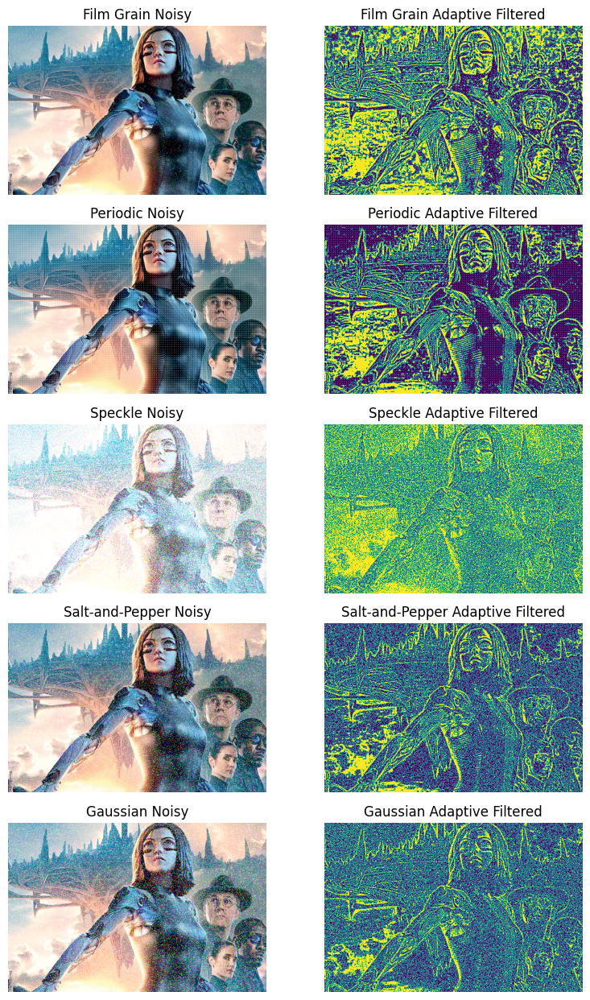

In [15]:
def apply_adaptive_filter(image):
    gray_image = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    return cv2.adaptiveThreshold(gray_image, 255, cv2.ADAPTIVE_THRESH_GAUSSIAN_C, cv2.THRESH_BINARY, 11, 2)

num_noises = len(noisy_images)
num_images = num_noises + 1

plt.figure(figsize=(8, 15))

for i, (noise_type, noisy_image) in enumerate(noisy_images.items(), start=1):
    plt.subplot(num_images, 2, i * 2 - 1)
    plt.imshow(noisy_image)
    plt.title(noise_type + ' Noisy')
    plt.axis('off')

    adaptive_filtered = apply_adaptive_filter(noisy_image)

    plt.subplot(num_images, 2, i * 2)
    plt.imshow(adaptive_filtered)
    plt.title(noise_type + ' Adaptive Filtered')
    plt.axis('off')

plt.tight_layout()
plt.savefig('adaptive_filter_output.png', bbox_inches='tight')
plt.show()

##  Bilateral Filter

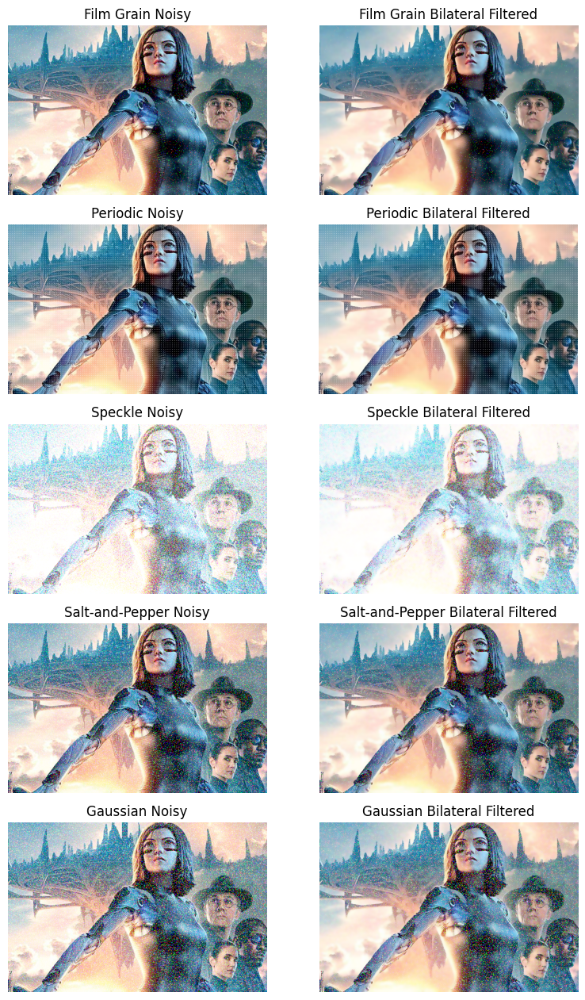

In [16]:
def apply_bilateral_filter(image):
    return cv2.bilateralFilter(image, 9, 75, 75)

num_noises = len(noisy_images)
num_images = num_noises + 1

plt.figure(figsize=(8, 15))

for i, (noise_type, noisy_image) in enumerate(noisy_images.items(), start=1):
    plt.subplot(num_images, 2, i * 2 + 1)
    plt.imshow(noisy_image)
    plt.title(noise_type + ' Noisy')
    plt.axis('off')

    bilateral_filtered = apply_bilateral_filter(noisy_image)

    plt.subplot(num_images, 2, i * 2 + 2)
    plt.imshow(bilateral_filtered)
    plt.title(noise_type + ' Bilateral Filtered')
    plt.axis('off')

plt.tight_layout()
# Save the generated output
plt.savefig('output.png', bbox_inches='tight')
plt.savefig('bilateral_filter_output.png', bbox_inches='tight')
plt.show()